## Feature Extraction

We'll be using NMFk to perform feature extraction and clustering on county-level demographic data and COVID-19 data. 

First, let's import some packages!

In [2]:
import XLSX
import NMFk
import SVR
import Statistics
import LinearAlgebra
import Dates
import Mads
import DataFrames
import Cairo, Fontconfig

Next, we'll read in the data from an xlsx file. The dataset contains case and death rates for covid-19 along with relevant demographic data at the county-level. All of the data within this file is publicly available from various sources. There are 3,142 counties with 804 demographic features.

In [3]:
ev, eh = XLSX.readtable("Data/CountyData (09-02-2020).xlsx", "Export"; header=true, stop_in_empty_row=false);
ncounties = length(ev[1])

3142

 Because the population of counties is so variable across the country, we'll want to normalize for population. We'll create a weight that we'll use later on. Also we  we'll want to keep track of the individual counites using the fips number (unique to each county). Note that fips 46102 is renamed to 46113 due to an outdated name.
 
 Then we'll clean up some of the variable names and initialize an array of data, M.

In [4]:
weight = ev[6] ./ maximum(ev[6]);
statecounty = ev[3] .* " " .* ev[4];
fips = parse.(Int64, ev[5]);
fips[indexin(46102, fips)[1]] = 46113;
skipvar = 5;
varnames = NMFk.replace(String.(eh[skipvar+1:end]), "denomin-ational" => "denominational", "busin-esses" => "businesses", "partici-pation" => "participation", "Retire-ment" => "Retirement", "Agri-culture" => "Agriculture", r" +" => " ", "\t" => " ");
nvar = length(varnames);
M = Array{Float32}(undef, ncounties, nvar);

In [5]:
for i in 1:nvar
	@show varnames[i]
	try
		M[:, i] = NMFk.processdata(ev[i+skipvar]; nanstring="x")
	catch
        display(ev[i+skipvar][2:end])
	end
end
varid = parse.(Int64, map(i->split(i, ' ')[2], varnames));
#NMFk.plotscatter(M[:,indexin(466, varid)[1]], M[:,indexin(325, varid)[1]])


varnames[i] = "COLUMN:  78  - Popn count (2015) (per 100,000)"
varnames[i] = 

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

"COLUMN: 21 | CATEGORY: '2016 ELECTION' | VARIABLE: '' | UNITS: '(%)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 998 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Case rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 999 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Death rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 1000 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Worst week - cases (weekly cases per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 1001 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Worst week - deaths (weekly deaths per million)' | UNITS: 'Rate'' | COVERAGE: '78.5%'"
varnames[i] = "COLUMN: 1002 | CATEGORY: 'COVID-19 (06-17-2020)' | VARIABLE: 'Case rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 1003 | CATEGORY: 'COVID-19 (06-17-2020)' | VARIABLE: 'Death rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "C

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

varnames[i] = "COLUMN: 487 | CATEGORY: 'IHME Cardiovascular Mortalityt Rates' | VARIABLE: 'Mortality Rate, 2014* Hemorrhagic stroke' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 793 | CATEGORY: 'Incarceration Trends' | VARIABLE: 'black_jail_pop_rate' | UNITS: 'Total Population'' | COVERAGE: '94.3%'"
varnames[i] = "COLUMN: 107 | CATEGORY: 'ESRI COUNTIES DATA (2015)' | VARIABLE: 'House-holds' | UNITS: '(count)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 674 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'MP_NOVEH' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"
varnames[i] = "COLUMN: 371 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'personal' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 368 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'devharmOppose' |

3141-element Array{Any,1}:
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
    2020-04-04
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

"COLUMN: 721 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_TOTAL' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 714 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_THEME3' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 209 | CATEGORY: 'Institute for Health Metrics and Evaluation (2010/11)' | VARIABLE: 'Male sufficient activity' | UNITS: '(%)'' | COVERAGE: '99.5%'"
varnames[i] = "COLUMN: 672 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'MP_CROWD' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 934 | CATEGORY: 'PUMA Household Data' | VARIABLE: 'MULTG' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 632 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'M_SNGPNT' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 617 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'E_POV' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 278 | CATEGORY: 'County Health Ran

3141-element Array{Any,1}:
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
    2020-03-28
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
    2020-03-20
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

varnames[i] = "COLUMN: 644 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'M_NOVEH' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 265 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Primary care physicians' | UNITS: 'PCP Rate'' | COVERAGE: '95.7%'"
varnames[i] = "COLUMN: 641 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'E_CROWD' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 122 | CATEGORY: 'ESRI COUNTIES DATA (2015)' | VARIABLE: 'Average farm size' | UNITS: '(count)'' | COVERAGE: '98.0%'"
varnames[i] = "COLUMN: 366 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'futuregenOppose' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 337 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Demographics' | UNITS: '% Not Proficient in English'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 

3141-element Array{Any,1}:
 385.12
 613.4
 425.74
 587.87
 501.39
 699.43
 559.92
 441.72
 680.28
 717.08
 884.57
 865.13
 380.32
   ⋮
 214.83
 126.99
 NaN
  69.29
 NaN
  61.06
 NaN
 224.16
 125.58
 202.51
 NaN
 NaN

varnames[i] = "COLUMN: 311 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Drug overdose deaths' | UNITS: 'Drug Overdose Mortality Rate'' | COVERAGE: '52.7%'"
varnames[i] = "COLUMN: 615 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'E_HH' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 972 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'HINS1' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 655 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'EP_AGE65' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 951 | CATEGORY: 'PUMA Household Data' | VARIABLE: 'R60' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 593 | CATEGORY: 'IHME Mortality Risk' | VARIABLE: 'Mortality risk, 2014* Mortality risk, age 25-45' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 339 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthranki

3141-element Array{Any,1}:
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 ⋮
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19

3141-element Array{Any,1}:
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 ⋮
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15

varnames[i] = "COLUMN: 704 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_PCI' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 613 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'E_HU' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 558 | CATEGORY: 'IHME Cancer Mortality' | VARIABLE: '% Change in Mortality Rate, 1980-2014 Malignant skin melanoma' | UNITS: 'Rate'' | COVERAGE: '8.3%'"
varnames[i] = "COLUMN: 702 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_POV' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 246 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Poor physical health days' | UNITS: 'Physically Unhealthy Days'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 869 | CATEGORY: 'US Polciy Database' | VARIABLE: 'MEDEXP Medicaid Expansion medicaid_expansion attribute flag' | UNITS: 'Classification'' | COVERAGE: '100.0%'"
varnames[i] 

3141-element Array{Any,1}:
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 2020-05-22
 ⋮
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15
 2020-05-15

3141-element Array{Any,1}:
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 2020-03-28
 ⋮
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19


varnames[i] = "COLUMN: 293 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Long commute - driving alone' | UNITS: '% Long Commute - Drives Alone'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 517 | CATEGORY: 'IHME Diabetes Prevalence' | VARIABLE: 'Percent Change, 1999-2012, Both Sexes Undiagnosed' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 325 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Residential segregation - black/white' | UNITS: 'Segregation index'' | COVERAGE: '65.3%'"
varnames[i] = "COLUMN: 944 | CATEGORY: 'PUMA Household Data' | VARIABLE: 'FPARC' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 973 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'HINS2' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 493 | CATEGORY: 'IHME Cardiovascular Mortalityt Rates' | VARIABLE: 'Mortality Rate, 

3141-element Array{Any,1}:
  9412.78
 10117.09
 10817.25
 10035.61
  9275.93
 10407.71
 10672.9
  8622.91
 10866.85
 10204.89
 11424.18
  9806.49
  9843.28
     ⋮
  8088.12
  8258.05
  7780.41
  7031.1
  7616.67
  5986.96
  6729.51
  7753.34
  7114.08
  7856.7
  8014.82
   NaN

3141-element Array{Any,1}:
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 ⋮
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01

3141-element Array{Any,1}:
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
    2020-04-30
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
    2020-04-03
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 ⋮
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13
 2020-03-13

3141-element Array{Any,1}:
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 ⋮
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19

"COLUMN: 529 | CATEGORY: 'IHME Diabetes Prevalence' | VARIABLE: 'Percent Change, 1999-2012, Both Sexes Awareness' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 746 | CATEGORY: 'Medicare Reimbursements' | VARIABLE: 'Total Medicare reimbursements per enrollee (Parts A and B) (2014) Price, age, sex & race-adjusted' | UNITS: '\$/enrollee'' | COVERAGE: '99.8%'"
varnames[i] = "COLUMN: 353 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'happening' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 554 | CATEGORY: 'IHME Cancer Mortality' | VARIABLE: '% Change in Mortality Rate, 1980-2014 Larynx cancer' | UNITS: 'Rate'' | COVERAGE: '8.3%'"
varnames[i] = "COLUMN: 849 | CATEGORY: 'US Polciy Database' | VARIABLE: 'ENDELECP Resumed elective medical procedures unemployment_waiting_prior attribute flag' | UNITS: 'Date'' | COVERAGE: '77.1%'"
varnames[i] = "COLUMN: 822 | CATEGORY: 'US Polciy Database' | VARIABLE: 'ENDGYM Reopened gyms gym_closure end date' | UNITS: 'Date'' | COV

varnames[i] = "COLUMN: 275 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'High school graduation' | UNITS: 'Graduation Rate'' | COVERAGE: '85.0%'"
varnames[i] = "COLUMN: 440 | CATEGORY: 'Flyover education' | VARIABLE: 'Bachelor's degree (25+)' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 752 | CATEGORY: 'Medicare Reimbursements' | VARIABLE: 'Outpatient facility reimbursements per enrollee (2014) Price, age, sex & race-adjusted' | UNITS: '\$/enrollee'' | COVERAGE: '99.8%'"
varnames[i] = "COLUMN: 841 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RACEDEAT Report deaths by race/ethnicity race_deaths attribute flag' | UNITS: 'Classification'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 703 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_UNEMP' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 966 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'DEYE' | UNITS: 'Rate'' | COVERAGE: '

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 2020-03-20
 ⋮
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19

3141-element Array{Any,1}:
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
  84.0957674219752
  90.1052631578947
  85.3571428571428
  91.3963328631876
  88.0597014925373
  81.419624217119
  81.4649397052255
  86.0714285714286
  88.1763527054108
  88.8059701492537
  87.0967741935484
  78.1176470588235
  87.1212121212121
   ⋮
  68.7830687830688
  82.4289405684755
  77.7777777777778
  83.0316742081448
  75.0
  74.7967479674797
  72.8571428571428
  77.8588807785888
  83.5164835164835
  78.3549783549784
  64.9253731343284
 NaN

3141-element Array{Any,1}:
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 2020-03-24
 ⋮
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01
 2020-04-01

3141-element Array{Any,1}:
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 2020-04-21
 ⋮
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16
 2020-04-16

varnames[i] = "COLUMN: 277 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Unemployment' | UNITS: '% Unemployed'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 950 | CATEGORY: 'PUMA Household Data' | VARIABLE: 'NR' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 180 | CATEGORY: 'IRS (2010) Tax Data' | VARIABLE: 'State-local taxes' | UNITS: '(\$M)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 351 | CATEGORY: 'USDA-ERS (Education, Poverty, and Unemployment)' | VARIABLE: 'Unemployment_rate_2016' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 172 | CATEGORY: 'IRS (2010) Tax Data' | VARIABLE: 'Adjusted gross income' | UNITS: '(\$M)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 734 | CATEGORY: 'Medicare County Rates' | VARIABLE: 'Average annual percent of diabetic Medicare enrollees age 65-75 having eye examination (2015) Overall' | UNITS: 'Rate'' | COVERAGE: '97.6%'"
varnames[i] = "COLUMN: 

3141-element Array{Any,1}:
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 2020-04-30
 ⋮
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
  8028.73
  8707.97
  9809.13
  8921.75
  8001.13
  8909.43
  9052.59
  7429.53
  9706.03
  9040.89
 10462.39
  8374.63
  8499.99
     ⋮
  8478.78
  8223.02
 10161.28
  7499.4
  8390.85
  6522.59
  7075.96
  8377.7
  7785.43
  8138.14
  8251.25
   NaN

"COLUMN: 809 | CATEGORY: 'US Polciy Database' | VARIABLE: 'END_BSNS Began to reopen businesses business_closure end date' | UNITS: 'Date'' | COVERAGE: '97.9%'"
varnames[i] = "COLUMN: 988 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'SCH' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 993 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'WRK' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 548 | CATEGORY: 'IHME Cancer Mortality' | VARIABLE: '% Change in Mortality Rate, 1980-2014 Liver cancer' | UNITS: 'Rate'' | COVERAGE: '8.3%'"
varnames[i] = "COLUMN: 708 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_AGE17' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 718 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'F_NOVEH' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 157 | CATEGORY: 'ERS (2010) Federal Spending' | VARIABLE: 'Federal (non-defense)' | UNITS: '(\$/person)'' | COVERAGE: '99.7%'"
varnames[i] = "COLUMN: 11

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 2020-03-23
 ⋮
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27
 2020-03-27

3141-element Array{Any,1}:
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 2020-05-11
 ⋮
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01
 2020-05-01

"COLUMN: 596 | CATEGORY: 'IHME Mortality Risk' | VARIABLE: '% Change in mortality risk, 1980-2014 Mortality risk, age 45-65' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 543 | CATEGORY: 'IHME Cancer Mortality' | VARIABLE: 'Mortality Rate, 2014* Stomach cancer' | UNITS: 'Rate'' | COVERAGE: '8.3%'"
varnames[i] = "COLUMN: 396 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'citizensOppose' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 482 | CATEGORY: 'IHME Cardiovascular Mortalityt Rates' | VARIABLE: '% Change in Mortality Rate, 1980-2014 Ischemic heart disease' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 888 | CATEGORY: 'Hypertension' | VARIABLE: 'Awareness, Male, 2009' | UNITS: 'Rate'' | COVERAGE: '99.6%'"
varnames[i] = "COLUMN: 450 | CATEGORY: 'Religion Rates (2010) (http://www.usreligioncensus.org/)' | VARIABLE: 'Non-denomin-ational' | UNITS: 'per 1,000'' | COVERAGE: '84.7%'"
varnames[i] = "COLUMN: 193 | CATEGORY: 'IRS (2010) Tax Data' | 

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
    2020-03-16
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN


varnames[i] = "COLUMN: 471 | CATEGORY: 'COVID Community Vulnerability Index' | VARIABLE: 'THEME 5: Epidemiological Factors' | UNITS: 'Index'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 334 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Demographics' | UNITS: '% Native Hawaiian/Other Pacific Islander'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 91 | CATEGORY: 'ESRI COUNTIES DATA (2015)' | VARIABLE: 'Popn: Females' | UNITS: '(count)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 697 | CATEGORY: 'CDC Social Vulnerabilty  Index' | VARIABLE: 'EPL_GROUPQ' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 862 | CATEGORY: 'US Polciy Database' | VARIABLE: 'TLHlBUPR Use of telemedicine/telephone evaluations to initiate buprenorphine prescribing telemedicine_buprenorphine start date' | UNITS: 'Date'' | COVERAGE: '2.3%'"
varnames[i] = "COLUMN: 565 | CATEGORY: 'IHME  Respriatory Disease Mortality' | VARIABL

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
  83.9273842588524
  87.7414325334306
  81.6697913465036
  84.8907859726217
  80.9844988795793
  86.9885330393223
  83.6922590913687
  83.8561835355832
  87.4603282799336
  77.7561076532882
  87.7529890052348
  79.5242831388641
  71.7354617652093
   ⋮
  70.5103900034143
  75.8385287113002
  70.1182108065101
  67.4362636499517
  68.1441281977496
  72.739992491736
  74.2146491543155
  74.1055179609362
  79.0922952707532
  76.5319343639944
  83.1053377602836
 NaN

"COLUMN: 456 | CATEGORY: 'Religion Rates (2010) (http://www.usreligioncensus.org/)' | VARIABLE: 'Seventh-day Adventist Church' | UNITS: 'per 1,000'' | COVERAGE: '57.9%'"
varnames[i] = "COLUMN: 313 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Motor vehicle crash deaths' | UNITS: 'MV Mortality Rate'' | COVERAGE: '85.6%'"
varnames[i] = "COLUMN: 772 | CATEGORY: 'Incarceration Trends' | VARIABLE: 'native_jail_pop' | UNITS: 'Total Population'' | COVERAGE: '94.4%'"
varnames[i] = "COLUMN: 385 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'rebates' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 971 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'DREM' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 758 | CATEGORY: 'Medicare Reimbursements' | VARIABLE: 'Durable medical equipment reimbursements per enrollee (2014) Price, age, sex & race-adjusted' | UNITS: '\$/enrollee'' | COVERAGE: '99.7%'"
varn

varnames[i] = "COLUMN: 174 | CATEGORY: 'IRS (2010) Tax Data' | VARIABLE: 'Adjusted gross income' | UNITS: '(\$/person)'' | COVERAGE: '99.9%'"
varnames[i] = "COLUMN: 131 | CATEGORY: 'ERS (2010) Federal Spending' | VARIABLE: 'Total' | UNITS: '(\$/person)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 363 | CATEGORY: 'Yale Climate Opinion' | VARIABLE: 'harmplants' | UNITS: '%'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 181 | CATEGORY: 'IRS (2010) Tax Data' | VARIABLE: 'State-local taxes' | UNITS: '(\$/return)'' | COVERAGE: '95.6%'"
varnames[i] = "COLUMN: 787 | CATEGORY: 'Incarceration Trends' | VARIABLE: 'total_jail_adm' | UNITS: 'Total Population'' | COVERAGE: '93.5%'"
varnames[i] = "COLUMN: 981 | CATEGORY: 'Puma Personal Data' | VARIABLE: 'MIG' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 766 | CATEGORY: 'Incarceration Trends' | VARIABLE: 'female_juvenile_jail_pop' | UNITS: 'Total Population'' | COVERAGE: '93.3%'"
varnames[i] = "COLUMN: 845 | CATEGORY: 'US Polciy Dat

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 ⋮
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19
 2020-03-19

3141-element Array{Any,1}:
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 2020-03-14
 ⋮
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18
 2020-03-18

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
    2020-03-19
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

3141-element Array{Any,1}:
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
   ⋮
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN
 NaN

varnames[i] = "COLUMN: 816 | CATEGORY: 'US Polciy Database' | VARIABLE: 'ALCOPEN Alcohol/Liquor Stores Open business_alcohol_exempt attribute flag' | UNITS: 'Classification'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 139 | CATEGORY: 'ERS (2010) Federal Spending' | VARIABLE: 'Retire-ment (other)' | UNITS: '(\$/person)'' | COVERAGE: '100.0%'"
varnames[i] = "COLUMN: 896 | CATEGORY: 'Medicare post Dischareg Events' | VARIABLE: 'Percent having an emergency room visit within 30 days of discharge (2015) Rate Medical cohort' | UNITS: 'Rate'' | COVERAGE: '78.5%'"
varnames[i] = "COLUMN: 323 | CATEGORY: 'County Health Rankings & Roadmaps (http://www.countyhealthrankings.org/explore-health-rankings)' | VARIABLE: 'Median household income' | UNITS: 'Household income (White)'' | COVERAGE: '87.8%'"
varnames[i] = "COLUMN: 840 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RACEHOSP Report hospitalizations by race/ethnicity race_hospitalizations attribute flag' | UNITS: 'Classification'' | COVERAGE: '9

LoadError: [91mArgumentError: input string is empty or only contains whitespace[39m

In [6]:
xindex = [collect(1:1); collect(10:nvar)];
yindex = 2:9;
xvar = varnames[xindex];
yvar = varnames[yindex];
X = M[:, xindex];
Y = M[:, yindex];
#r2 = NMFk.r2matrix(X, Y)

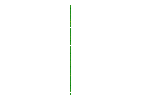

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                        …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                          NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                     NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                        NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Database' | VARIABLE: 'CLBSNS Closed non-essential businesses business_clos

yvar[i] = "COLUMN: 21 | CATEGORY: '2016 ELECTION' | VARIABLE: '' | UNITS: '(%)'' | COVERAGE: '100.0%'"
yvar[i] = 

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                                       …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                                         NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                                    NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                                       NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Database' | VAR

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                        …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                          NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                     NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                        NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Database' | VARIABLE: 'CLBSNS Closed non-essential businesses business_clos

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                                    …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                                      NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                                 NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                                    NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Database' | VARIABLE: 'CLBS

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                                                   …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                                                     NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                                                NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                                                   NaN
 "CO

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                                         …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                                           NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                                      NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                                         NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Databas

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                                                           …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                                                             NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                                                        NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                                   

796×2 Array{Any,2}:
 "COLUMN: 827 | CATEGORY: 'US Polciy Database' | VARIABLE: 'RNTGP Renter grace period or use of security deposit to pay rent renter_grace start date' | UNITS: 'Date'' | COVERAGE: '0.9%'"                        …  NaN
 "COLUMN: 811 | CATEGORY: 'US Polciy Database' | VARIABLE: 'FM_ALL Mandate face mask use by all individuals in public spaces public_masks start date' | UNITS: 'Date'' | COVERAGE: '23.1%'"                          NaN
 "COLUMN: 863 | CATEGORY: 'US Polciy Database' | VARIABLE: 'EXTOPFL Patients can receive 14-28 take-home doses of opioid medication opioid_dose start date' | UNITS: 'Date'' | COVERAGE: '2.6%'"                     NaN
 "COLUMN: 806 | CATEGORY: 'US Polciy Database' | VARIABLE: 'STAYHOME Stay at home/ shelter in place shelter start date' | UNITS: 'Date'' | COVERAGE: '71.5%'"                                                        NaN
 "COLUMN: 808 | CATEGORY: 'US Polciy Database' | VARIABLE: 'CLBSNS Closed non-essential businesses business_clos

"COLUMN: 998 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Case rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
yvar[i] = "COLUMN: 999 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Death rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
yvar[i] = "COLUMN: 1000 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Worst week - cases (weekly cases per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
yvar[i] = "COLUMN: 1001 | CATEGORY: 'COVID-19 (05-07-2020)' | VARIABLE: 'Worst week - deaths (weekly deaths per million)' | UNITS: 'Rate'' | COVERAGE: '78.5%'"
yvar[i] = "COLUMN: 1002 | CATEGORY: 'COVID-19 (06-17-2020)' | VARIABLE: 'Case rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
yvar[i] = "COLUMN: 1003 | CATEGORY: 'COVID-19 (06-17-2020)' | VARIABLE: 'Death rate (per million)' | UNITS: 'Rate'' | COVERAGE: '100.0%'"
yvar[i] = "COLUMN: 1004 | CATEGORY: 'COVID-19 (06-17-2020)' | VARIABLE: 'Worst week - cases (weekly cases per million)' | UNITS: 'Rate'' | COVE

In [7]:
xindex = [collect(1:1); collect(10:nvar)];
yindex = 2:9;
xvar = varnames[xindex];
yvar = varnames[yindex];
X = M[:, xindex];
Y = M[:, yindex];
r2 = NMFk.r2matrix(X, Y)
for i = 1:length(yvar)
	@show yvar[i]
	is = sortperm(r2[:,i]; rev=true)
	display([xvar r2][is,[1,i+1]])
end

Use the NMFk function normalizematrix_col to normalize the matrix by column.
    
Then we inflate the covid related features by a factor of 10.

In [8]:
Mn, nmin, nmax = NMFk.normalizematrix_col!(M)
Mn_COVID = Mn
Mn_COVID[:,3:18] = Mn_COVID[:,3:18]*10

3142×16 Array{Float32,2}:
 0.0864532   0.181979   0.0248965   …  0.892706   0.232081     0.403355
 0.0731172   0.0759069  0.0175243      0.407982   0.306961     0.117062
 0.158552    0.137284   0.0528237      0.614892   0.302963     0.184372
 0.159904    0.0        0.0582302      0.774658   0.258569     0.41454
 0.0604853   0.0        0.0180404      0.412497   0.245324     0.214699
 0.148399    0.335511   0.0516387   …  3.00549    0.942161     1.2607
 0.556663    0.348519   0.344195       4.12552    0.422702     1.17126
 0.0835663   0.0894943  0.0306091      0.687158   0.327507     0.254274
 0.766304    2.24208    0.287566       2.60836    0.265939     0.844305
 0.0572218   0.0        0.0165929      0.99334    0.161726     0.301963
 0.11434     0.0762807  0.0254375   …  0.63451    0.284298     0.402788
 0.357212    0.0        0.151922       2.06701    0.388779     1.4384
 0.158643    0.143468   0.055203       1.28518    1.1757       0.53526
 ⋮                                  ⋱        

Run NMFk on the normalized matrix using a k-range from 2-7. Then we'll cluster the results using the NMFk.clusterresults() function. 

In [9]:
nkrange = 2:7
NMFk.execute(Mn_COVID, nkrange; resultdir="results-nmfk-COVID", casefilename="nmfk-n-$(join(size(Mn), '_'))", load=true)
W, H, fitquality, robustness, aic = NMFk.load(nkrange; resultdir="results-nmfk-COVID", casefilename="nmfk-n-$(join(size(Mn), '_'))")
NMFk.getks(nkrange, robustness[nkrange])
NMFk.clusterresults(NMFk.getks(nkrange, robustness[nkrange]), W, H, statecounty, varnames; Wcasefilename="counties", Hcasefilename="attr", resultdir="results-nmfk-COVID", figuredir="figures-nmfk-covid")


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  2 Fit: 1.93942e+07 Silhouette:    0.9999985 AIC:      4955461


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit: 1.249788e+07 Silhouette:    0.9849251 AIC:      3938668


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  4 Fit:      9730319 Silhouette:    0.3164945 AIC:      3362848


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:      7020819 Silhouette:    0.5223086 AIC:      2609675


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  6 Fit:      4307694 Silhouette:    0.6797814 AIC:      1478472


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  7 Fit:      3266221 Silhouette: -0.004043506 AIC:     840956.9
Signals:  2 Fit: 1.93942e+07 Silhouette:    0.9999985 AIC:      4955461
Signals:  3 Fit: 1.249788e+07 Silhouette:    0.9849251 AIC:      3938668
Signals:  4 Fit:      9730319 Silhouette:    0.3164945 AIC:      3362848
Signals:  5 Fit:      7020820 Silhouette:    0.5223086 AIC:      2609676
Signals:  6 Fit:      4307694 Silhouette:    0.6797814 AIC:      1478472
Signals:  7 Fit:      3266221 Silhouette: -0.004043506 AIC:     840956.9


┌ Info: Results
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:15
┌ Info: Optimal solution: 6 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:20
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  2 Fit: 1.93942e+07 Silhouette:    0.9999985 AIC:      4955461


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit: 1.249788e+07 Silhouette:    0.9849251 AIC:      3938668


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  4 Fit:      9730319 Silhouette:    0.3164945 AIC:      3362848


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:      7020819 Silhouette:    0.5223086 AIC:      2609675


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  6 Fit:      4307694 Silhouette:    0.6797814 AIC:      1478472


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  7 Fit:      3266221 Silhouette: -0.004043506 AIC:     840956.9


┌ Info: Optimal solution: 6 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkIO.jl:30
┌ Info: Number of signals: 2
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:96
┌ Info: Attr (signals=2)
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:98
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} not present in workspace; reconstructing
└ @ JLD /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:697
Error encountered while load FileIO.File{FileIO.DataFormat{:JLD},String}("results-nmfk-COVID/Hmatrix-2-2_804-1000.jld").

Fatal error:


LoadError: [91m[91mstored type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} does not match currently loaded type[39m[39m
[91mjldatatype(::JLD.JldFile, ::HDF5.HDF5Datatype) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:723[39m
[91mread(::JLD.JldDataset) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:367[39m
[91mread(::JLD.JldFile, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:343[39m
[91m#49 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mmap at ./tuple.jl:158 [inlined][39m
[91m#48 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mjldopen(::JLD.var"#48#50"{Tuple{String,String}}, ::String, ::Vararg{String,N} where N; kws::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:243[39m
[91mjldopen(::Function, ::String, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:241[39m
[91mload at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1257 [inlined][39m
[91mload(::FileIO.File{FileIO.DataFormat{:JLD},String}, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1255[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N; kwargs::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at ./essentials.jl:710[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N) at ./essentials.jl:709[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:217[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:197[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91mload(::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:113[39m
[91mload at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:110 [inlined][39m
[91mrobustkmeans(::Array{AbstractFloat,2}, ::Int64, ::Int64; maxiter::Int64, tol::Float64, display::Symbol, distance::Distances.CosineDist, resultdir::String, casefilename::String, save::Bool, load::Bool) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkCluster.jl:66[39m
[91mclusterresults(::Array{Int64,1}, ::Array{Array{AbstractFloat,2},1}, ::Array{Array{AbstractFloat,2},1}, ::Array{String,1}, ::Array{String,1}; clusterattributes::Bool, loadassignements::Bool, Wsize::Int64, Hsize::Int64, Wmap::Array{Any,1}, Hmap::Array{Any,1}, lon::Nothing, lat::Nothing, hover::Nothing, resultdir::String, figuredir::String, Wcasefilename::String, Hcasefilename::String, Htypes::Array{Any,1}, Wtypes::Array{Any,1}, Hcolors::Array{String,1}, Wcolors::Array{String,1}, background_color::String, createplots::Bool, createbiplots::Bool, Wplotlabel::Bool, Hplotlabel::Bool, plottimeseries::Symbol, biplotlabel::Symbol, biplotcolor::Symbol, cutoff::Int64, cutoff_s::Int64, Wmatrix_font_size::Measures.Length{:mm,Float64}, Hmatrix_font_size::Measures.Length{:mm,Float64}, plotmatrixformat::String, biplotformat::String, plotseriesformat::String, sortmag::Bool, point_size_nolabel::Measures.Length{:mm,Float64}, point_size_label::Measures.Length{:mm,Float64}) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:134[39m
[91mtop-level scope at In[9]:5[39m
[91minclude_string(::Function, ::Module, ::String, ::String) at ./loading.jl:1091[39m
[91msoftscope_include_string(::Module, ::String, ::String) at /Users/ctalsma/.julia/packages/SoftGlobalScope/u4UzH/src/SoftGlobalScope.jl:65[39m
[91mexecute_request(::ZMQ.Socket, ::IJulia.Msg) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/execute_request.jl:67[39m
[91m#invokelatest#1 at ./essentials.jl:710 [inlined][39m
[91minvokelatest at ./essentials.jl:709 [inlined][39m
[91meventloop(::ZMQ.Socket) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/eventloop.jl:8[39m
[91m(::IJulia.var"#15#18")() at ./task.jl:356[39m

We perform the same functions as the previous step, but this time we use the population weight created previously to weight each counties influence on the NMFk output by the population of the county. We set the weight parameter in the NMFk.execute() function to the weight created above using population of the county

In [10]:
NMFk.execute(Mn_COVID, nkrange; weight=weight, resultdir="results-nmfk-COVID", casefilename="nmfk-nw-$(join(size(Mn), '_'))", load=true)
W, H, fitquality, robustness, aic = NMFk.load(nkrange; resultdir="results-nmfk-COVID", casefilename="nmfk-nw-$(join(size(Mn), '_'))")
NMFk.clusterresults(NMFk.getks(nkrange, robustness[nkrange]), W, H, statecounty, varnames; Wcasefilename="counties", Hcasefilename="attr", resultdir="results-nw-covid", figuredir="figures-nw-covid")


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  2 Fit:      51492.4 Silhouette:    0.9955949 AIC:     -8875915


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit:     43425.72 Silhouette:    0.9625161 AIC:     -9265343


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  4 Fit:     37801.11 Silhouette:    0.5079757 AIC:     -9580921


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:     35834.54 Silhouette:   0.09269063 AIC:     -9697616


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  6 Fit:     34591.34 Silhouette:    0.4286142 AIC: -1.079207e+07
Signals:  7 Fit:     32737.43 Silhouette:   -0.0845089 AIC: -1.092333e+07
Signals:  2 Fit:      51492.4 Silhouette:    0.9955949 AIC:     -8875915
Signals:  3 Fit:     43425.72 Silhouette:    0.9625161 AIC:     -9265343
Signals:  4 Fit:     37801.11 Silhouette:    0.5079757 AIC:     -9580921
Signals:  5 Fit:     35834.54 Silhouette:   0.09269062 AIC:     -9697616
Signals:  6 Fit:     34591.34 Silhouette:    0.4286142 AIC: -1.079207e+07
Signals:  7 Fit:     32737.43 Silhouette:   -0.0845089 AIC: -1.092333e+07


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Info: Results
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:15
┌ Info: Optimal solution: 6 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:20
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  2 Fit:      51492.4 Silhouette:    0.9955949 AIC:     -8875915


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit:     43425.72 Silhouette:    0.9625161 AIC:     -9265343


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  4 Fit:     37801.11 Silhouette:    0.5079757 AIC:     -9580921


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:     35834.54 Silhouette:   0.09269063 AIC:     -9697616
Signals:  6 Fit:     34591.34 Silhouette:    0.4286142 AIC: -1.079207e+07


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  7 Fit:     32737.43 Silhouette:   -0.0845089 AIC: -1.092333e+07


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Info: Optimal solution: 6 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkIO.jl:30
┌ Info: Number of signals: 2
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:96
┌ Info: Attr (signals=2)
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:98
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} not present in workspace; reconstructing
└ @ JLD /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:697
Error encountered while load FileIO.File{FileIO.DataFormat{:JLD},String}("results-nw-covid/Hmatrix-2-2_804-1000.jld").

Fatal error:


LoadError: [91m[91mstored type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} does not match currently loaded type[39m[39m
[91mjldatatype(::JLD.JldFile, ::HDF5.HDF5Datatype) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:723[39m
[91mread(::JLD.JldDataset) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:367[39m
[91mread(::JLD.JldFile, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:343[39m
[91m#49 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mmap at ./tuple.jl:158 [inlined][39m
[91m#48 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mjldopen(::JLD.var"#48#50"{Tuple{String,String}}, ::String, ::Vararg{String,N} where N; kws::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:243[39m
[91mjldopen(::Function, ::String, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:241[39m
[91mload at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1257 [inlined][39m
[91mload(::FileIO.File{FileIO.DataFormat{:JLD},String}, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1255[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N; kwargs::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at ./essentials.jl:710[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N) at ./essentials.jl:709[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:217[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:197[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91mload(::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:113[39m
[91mload at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:110 [inlined][39m
[91mrobustkmeans(::Array{AbstractFloat,2}, ::Int64, ::Int64; maxiter::Int64, tol::Float64, display::Symbol, distance::Distances.CosineDist, resultdir::String, casefilename::String, save::Bool, load::Bool) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkCluster.jl:66[39m
[91mclusterresults(::Array{Int64,1}, ::Array{Array{AbstractFloat,2},1}, ::Array{Array{AbstractFloat,2},1}, ::Array{String,1}, ::Array{String,1}; clusterattributes::Bool, loadassignements::Bool, Wsize::Int64, Hsize::Int64, Wmap::Array{Any,1}, Hmap::Array{Any,1}, lon::Nothing, lat::Nothing, hover::Nothing, resultdir::String, figuredir::String, Wcasefilename::String, Hcasefilename::String, Htypes::Array{Any,1}, Wtypes::Array{Any,1}, Hcolors::Array{String,1}, Wcolors::Array{String,1}, background_color::String, createplots::Bool, createbiplots::Bool, Wplotlabel::Bool, Hplotlabel::Bool, plottimeseries::Symbol, biplotlabel::Symbol, biplotcolor::Symbol, cutoff::Int64, cutoff_s::Int64, Wmatrix_font_size::Measures.Length{:mm,Float64}, Hmatrix_font_size::Measures.Length{:mm,Float64}, plotmatrixformat::String, biplotformat::String, plotseriesformat::String, sortmag::Bool, point_size_nolabel::Measures.Length{:mm,Float64}, point_size_label::Measures.Length{:mm,Float64}) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:134[39m
[91mtop-level scope at In[10]:3[39m
[91minclude_string(::Function, ::Module, ::String, ::String) at ./loading.jl:1091[39m
[91msoftscope_include_string(::Module, ::String, ::String) at /Users/ctalsma/.julia/packages/SoftGlobalScope/u4UzH/src/SoftGlobalScope.jl:65[39m
[91mexecute_request(::ZMQ.Socket, ::IJulia.Msg) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/execute_request.jl:67[39m
[91m#invokelatest#1 at ./essentials.jl:710 [inlined][39m
[91minvokelatest at ./essentials.jl:709 [inlined][39m
[91meventloop(::ZMQ.Socket) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/eventloop.jl:8[39m
[91m(::IJulia.var"#15#18")() at ./task.jl:356[39m

We plot the various signals generated in the previous clustering as a map of counties within the US.

┌ Info: Make dir maps-nw-covid
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkIO.jl:114


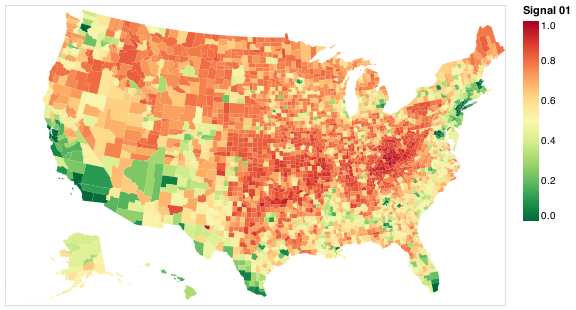

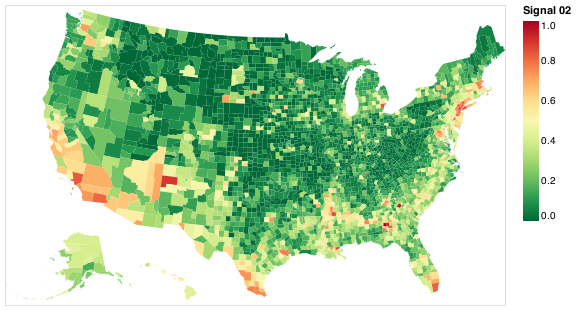

┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} not present in workspace; reconstructing
└ @ JLD /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:697
Error encountered while load FileIO.File{FileIO.DataFormat{:JLD},String}("results-nw-covid/Hmatrix-2-2_804-1000.jld").

Fatal error:


LoadError: [91m[91mstored type Clustering.KmeansResult{Core.Array{Core.AbstractFloat,2},Core.Float64,Core.Int64} does not match currently loaded type[39m[39m
[91mjldatatype(::JLD.JldFile, ::HDF5.HDF5Datatype) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:723[39m
[91mread(::JLD.JldDataset) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:367[39m
[91mread(::JLD.JldFile, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:343[39m
[91m#49 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mmap at ./tuple.jl:158 [inlined][39m
[91m#48 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mjldopen(::JLD.var"#48#50"{Tuple{String,String}}, ::String, ::Vararg{String,N} where N; kws::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:243[39m
[91mjldopen(::Function, ::String, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:241[39m
[91mload at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1257 [inlined][39m
[91mload(::FileIO.File{FileIO.DataFormat{:JLD},String}, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1255[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N; kwargs::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at ./essentials.jl:710[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N) at ./essentials.jl:709[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:217[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:197[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91mload(::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:113[39m
[91mload at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:110 [inlined][39m
[91mrobustkmeans(::Array{AbstractFloat,2}, ::Int64, ::Int64; maxiter::Int64, tol::Float64, display::Symbol, distance::Distances.CosineDist, resultdir::String, casefilename::String, save::Bool, load::Bool) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkCluster.jl:66[39m
[91msignalorder(::Array{AbstractFloat,2}, ::Array{AbstractFloat,2}; resultdir::String, loadassignements::Bool, Wclusterlabelcasefilename::String, Hclusterlabelcasefilename::String) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:390[39m
[91mtop-level scope at ./In[11]:4[39m
[91minclude_string(::Function, ::Module, ::String, ::String) at ./loading.jl:1091[39m
[91msoftscope_include_string(::Module, ::String, ::String) at /Users/ctalsma/.julia/packages/SoftGlobalScope/u4UzH/src/SoftGlobalScope.jl:65[39m
[91mexecute_request(::ZMQ.Socket, ::IJulia.Msg) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/execute_request.jl:67[39m
[91m#invokelatest#1 at ./essentials.jl:710 [inlined][39m
[91minvokelatest at ./essentials.jl:709 [inlined][39m
[91meventloop(::ZMQ.Socket) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/eventloop.jl:8[39m
[91m(::IJulia.var"#15#18")() at ./task.jl:356[39m

In [11]:
for k in NMFk.getks(nkrange, robustness[nkrange])
	Wa, _, _ = NMFk.normalizematrix_col!(W[k])
	NMFk.plotmap(Wa, fips, 2; titletext="Signal", title=false, figuredir="maps-nw-covid", casefilename="signals$k")
	Wclusterlabelsnew, Wsignalmapnew, Hclusterlabels, Hclustermap = NMFk.signalorder(W[k], H[k]; resultdir="results-nw-covid")
	NMFk.plotmap(Wsignalmapnew, fips; figuredir="maps-nw-covid", casefilename="signals$k")
	NMFk.plotmap(Wclusterlabelsnew, fips; figuredir="maps-nw-covid", casefilename="signals$k-labeled")
end


In [12]:
Mnl = log10.(Mn)
Mnl[isinf.(Mnl)] .= -8
Mnln, nlnmin, nlnmax = NMFk.normalizematrix_col!(Mnl)
Mn_COVID = Mnln
Mn_COVID[:,3:18] = Mn_COVID[:,3:18]*10

3142×16 Array{Float32,2}:
 7.70753  8.06669  7.10682    8.46708  …  8.83412  8.18404    8.45076
 7.62669  7.64476  6.93738    7.9943      8.45627  8.31898    7.8538
 8.00019  7.93069  7.46981    8.52674     8.65422  8.31266    8.07299
 8.00429  0.0      7.51683    0.0         8.76568  8.2362     8.46396
 7.53517  0.0      6.95139    0.0         8.46158  8.21082    8.14648
 7.96826  8.3619   7.45886    0.0      …  9.41991  8.86014    9.00068
 8.60621  8.38025  8.37423    0.0         9.57275  8.47337    8.96517
 7.69115  7.72422  7.2065     0.0         8.70784  8.35025    8.22811
 8.76045  9.2785   8.28749    0.0         9.35152  8.24976    8.80722
 7.5084   0.0      6.91103    0.0         8.88566  8.00976    8.31106
 7.84244  7.64713  7.11719    0.0      …  8.66938  8.28197    8.45008
 8.39214  0.0      7.97958    0.0         9.23927  8.433      9.06431
 8.00047  7.95195  7.49107    0.0         9.00996  8.967      8.58729
 ⋮                                     ⋱                      ⋮
 

In [13]:
NMFk.execute(Mnln, nkrange; weight=weight, resultdir="results-nmfk-COVID", casefilename="nmfk-nlnw-$(join(size(Mnln), '_'))", load=true)
W, H, fitquality, robustness, aic = NMFk.load(nkrange; resultdir="results-nmfk-covid", casefilename="nmfk-nlnw-$(join(size(Mn), '_'))")
NMFk.clusterresults(NMFk.getks(nkrange, robustness[nkrange]), W, H, statecounty, string.(varid); Wcasefilename="counties", Hcasefilename="attr", resultdir="results-nlnw-covid", figuredir="figures-nlnw-covid", Wplotlabel=false, Hplotlabel=true, biplotlabel=:none, biplotcolor=:W)
NMFk.clusterresults(NMFk.getks(nkrange, robustness[nkrange]), W, H, statecounty, varnames; Wcasefilename="counties", Hcasefilename="attr", resultdir="results-nlnw-covid", figuredir="figures-nlnw-covid", Wplotlabel=false, Hplotlabel=false, biplotlabel=:none, biplotcolor=:W)


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  2 Fit:     154198.6 Silhouette:    0.9901119 AIC:     -6318236


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit:     133015.4 Silhouette:    0.2342062 AIC:     -6654948
Signals:  4 Fit:     106773.3 Silhouette:  0.005034756 AIC:     -7159514


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:     99727.32 Silhouette:   -0.5329907 AIC:     -7310819


┌ Info: File results-nmfk-COVID/nmfk-nlnw-3142_804-6-10.jld is missing; runs will be executed!
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:56



OF: min 86.8503 max 220.08647 mean 148.51924 std 39.923344
Worst correlation by columns: 0.025664402
Worst correlation by rows: -0.00020738381
Worst norm by columns: 0.045785222
Worst norm by rows: 0.3757054
Signals:  6 Fit:     89822.05 Silhouette:    -0.224891 AIC:     -7546869


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Info: File results-nmfk-COVID/nmfk-nlnw-3142_804-7-10.jld is missing; runs will be executed!
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:56



OF: min 105.18738 max 216.87665 mean 161.26295 std 35.408127
Worst correlation by columns: 0.03080315
Worst correlation by rows: -0.00023726751
Worst norm by columns: 0.047023594
Worst norm by rows: 0.37489784
Signals:  7 Fit:     77502.07 Silhouette:    -0.537819 AIC:     -7882998


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Info: Results
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:15


Signals:  2 Fit:     154198.6 Silhouette:    0.9901119 AIC:     -6318236
Signals:  3 Fit:     133015.4 Silhouette:    0.2342062 AIC:     -6654948
Signals:  4 Fit:     106773.3 Silhouette:  0.005034756 AIC:     -7159514
Signals:  5 Fit:     99727.31 Silhouette:   -0.5329907 AIC:     -7310820
Signals:  6 Fit:     89822.05 Silhouette:    -0.224891 AIC:     -7546869
Signals:  7 Fit:     77502.07 Silhouette:    -0.537819 AIC:     -7882998
Signals:  2 Fit:     154198.6 Silhouette:    0.9901119 AIC:     -6318236


┌ Info: Optimal solution: 2 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkExecute.jl:20
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  3 Fit:     133015.4 Silhouette:    0.2342062 AIC:     -6654948
Signals:  4 Fit:     106773.3 Silhouette:  0.005034756 AIC:     -7159514


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  5 Fit:     99727.32 Silhouette:   -0.5329907 AIC:     -7310819
Signals:  6 Fit:     89822.05 Silhouette:    -0.224891 AIC:     -7546869


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215


Signals:  7 Fit:     77502.07 Silhouette:    -0.537819 AIC:     -7882998


┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Info: Optimal solution: 2 features
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkIO.jl:30


LoadError: [91mUndefVarError: varid not defined[39m

┌ Info: Make dir maps-nlnw-covid
└ @ NMFk /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkIO.jl:114


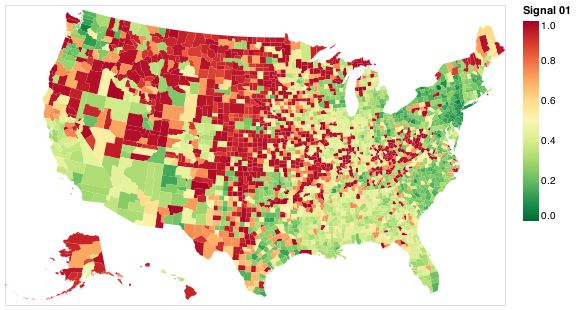

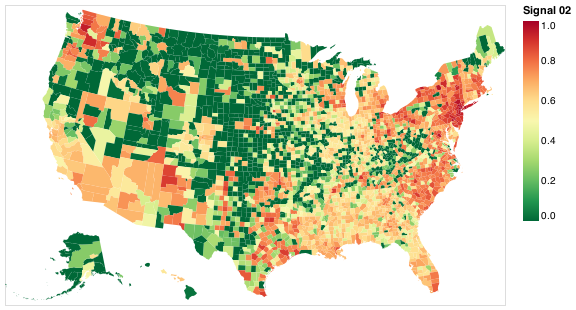

┌ Warning: JLD incorrectly extends FileIO functions (see FileIO documentation)
└ @ FileIO /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:215
┌ Warning: type Clustering.KmeansResult{Core.Array{Core.Float64,2},Core.Float64,Core.Int64} not present in workspace; reconstructing
└ @ JLD /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:697
Error encountered while load FileIO.File{FileIO.DataFormat{:JLD},String}("results-nlnw-covid/Hmatrix-2-2_804-1000.jld").

Fatal error:


LoadError: [91m[91mstored type Clustering.KmeansResult{Core.Array{Core.Float64,2},Core.Float64,Core.Int64} does not match currently loaded type[39m[39m
[91mjldatatype(::JLD.JldFile, ::HDF5.HDF5Datatype) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/jld_types.jl:723[39m
[91mread(::JLD.JldDataset) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:367[39m
[91mread(::JLD.JldFile, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:343[39m
[91m#49 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mmap at ./tuple.jl:158 [inlined][39m
[91m#48 at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1258 [inlined][39m
[91mjldopen(::JLD.var"#48#50"{Tuple{String,String}}, ::String, ::Vararg{String,N} where N; kws::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:243[39m
[91mjldopen(::Function, ::String, ::String) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:241[39m
[91mload at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1257 [inlined][39m
[91mload(::FileIO.File{FileIO.DataFormat{:JLD},String}, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/JLD/jeGJb/src/JLD.jl:1255[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N; kwargs::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at ./essentials.jl:710[39m
[91minvokelatest(::Any, ::Any, ::Vararg{Any,N} where N) at ./essentials.jl:709[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:217[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::FileIO.Formatted, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:197[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91maction(::Symbol, ::Array{Union{Base.PkgId, Module},1}, ::Symbol, ::String, ::String, ::Vararg{String,N} where N) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:185[39m
[91mload(::String, ::String, ::Vararg{String,N} where N; options::Base.Iterators.Pairs{Union{},Union{},Tuple{},NamedTuple{(),Tuple{}}}) at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:113[39m
[91mload at /Users/ctalsma/.julia/packages/FileIO/JA3Vl/src/loadsave.jl:110 [inlined][39m
[91mrobustkmeans(::Array{Float64,2}, ::Int64, ::Int64; maxiter::Int64, tol::Float64, display::Symbol, distance::Distances.CosineDist, resultdir::String, casefilename::String, save::Bool, load::Bool) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkCluster.jl:66[39m
[91msignalorder(::Array{Float64,2}, ::Array{Float64,2}; resultdir::String, loadassignements::Bool, Wclusterlabelcasefilename::String, Hclusterlabelcasefilename::String) at /Users/ctalsma/.julia/packages/NMFk/t59Nq/src/NMFkPostprocess.jl:390[39m
[91mtop-level scope at ./In[14]:4[39m
[91minclude_string(::Function, ::Module, ::String, ::String) at ./loading.jl:1091[39m
[91msoftscope_include_string(::Module, ::String, ::String) at /Users/ctalsma/.julia/packages/SoftGlobalScope/u4UzH/src/SoftGlobalScope.jl:65[39m
[91mexecute_request(::ZMQ.Socket, ::IJulia.Msg) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/execute_request.jl:67[39m
[91m#invokelatest#1 at ./essentials.jl:710 [inlined][39m
[91minvokelatest at ./essentials.jl:709 [inlined][39m
[91meventloop(::ZMQ.Socket) at /Users/ctalsma/.julia/packages/IJulia/e8kqU/src/eventloop.jl:8[39m
[91m(::IJulia.var"#15#18")() at ./task.jl:356[39m

In [14]:
for k in NMFk.getks(nkrange, robustness[nkrange])
	Wa, _, _ = NMFk.normalizematrix_col!(W[k])
	NMFk.plotmap(Wa, fips, 2; titletext="Signal", title=false, figuredir="maps-nlnw-covid", casefilename="signals$k")
	Wclusterlabelsnew, Wsignalmapnew, Hclusterlabels, Hclustermap = NMFk.signalorder(W[k], H[k]; resultdir="results-nlnw-covid")
	NMFk.plotmap(Wsignalmapnew, fips; figuredir="maps-nlnw-covid", casefilename="signals$k")
	NMFk.plotmap(Wclusterlabelsnew, fips; figuredir="maps-nlnw-covid", casefilename="signals$k-labeled")
end
